In [4]:
#Importing necessary libraries
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
RNG_SEED=42
np.random.seed(seed=RNG_SEED)
from sklearn.preprocessing import MinMaxScaler
%matplotlib inline
%config InlineBackend.figure_format='retina'

In [5]:
#Change path according to your file position.
data_path= '/content/data.csv'
df = pd.read_csv(data_path, encoding='latin-1')
print(f'Original Dataframe shape{df.shape}')

Original Dataframe shape(190, 27)


In [6]:
!pip install pandas-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 2.4 MB/s eta 0:00:00


In [2]:
!pip install ydata-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 359.5/359.5 kB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 6.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 13.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 17.7 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=9b3a9cca683a17e44f41c95f2eaa8af1cace0d0a788dac57f8b82f4531827538
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [7]:
#Profiling Data
from ydata_profiling import ProfileReport
profile=ProfileReport(df,title="Profiling Report")
profile.to_widgets()

/usr/local/lib/python3.10/dist-packages/ydata_profiling/profile_report.py:533: UserWarning: Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60).As an alternative, you can use the HTML report. See the documentation for more information.
  warnings.warn(


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [8]:
df.columns

Index(['SAE Grade', 'Conditions', 'UTS (MPa)', 'UTS (Ksi)', 'YS (MPa)',
       'YS (ksi)', 'Elongation (%)', 'Reduction (%)', 'Hardness (HB)',
       'C (Min)', 'C (Max)', 'Mn (Min)', 'Mn (Max)', 'P (Min)', 'P (Max)',
       'S (Min)', 'S(Max)', 'Si (Min)', 'Si (Max)', 'Ni (Min)', 'Ni (Max)',
       'Cr (Min)', 'Cr (Max)', 'Mo (Min)', 'Mo (Max)', 'Ti (Min)', 'Ti (Max)'],
      dtype='object')

In [9]:
# Check for columns with all NaN values
empty_columns = df.columns[df.isnull().all()]

# Drop columns with all NaN values
df.drop(empty_columns, axis=1, inplace=True)
df.columns

Index(['SAE Grade', 'Conditions', 'UTS (MPa)', 'UTS (Ksi)', 'YS (MPa)',
       'YS (ksi)', 'Elongation (%)', 'Reduction (%)', 'Hardness (HB)',
       'C (Min)', 'C (Max)', 'Mn (Min)', 'Mn (Max)', 'P (Min)', 'P (Max)',
       'S (Min)', 'S(Max)', 'Si (Min)', 'Si (Max)', 'Ni (Min)', 'Ni (Max)',
       'Cr (Min)', 'Cr (Max)', 'Mo (Min)', 'Mo (Max)'],
      dtype='object')

In [10]:
# Fill missing values with a specific value or a suitable strategy
df = df.fillna(method='ffill')

# Print a part of the DataFrame after handling missing values
print(df.head())

  SAE Grade  Conditions  UTS (MPa)  UTS (Ksi)  YS (MPa) YS (ksi)  \
0      1006  Hot rolled        295         43       165       24   
1      1006  Cold drawn        330         48       285       41   
2      1008  Hot rolled        305         44       170     24.5   
3      1008  Cold drawn        340         49       285       42   
4      1010  Hot rolled        325         47       180       26   

   Elongation (%) Reduction (%) Hardness (HB)  C (Min)  ...  S (Min)  S(Max)  \
0            30.0            55            86      NaN  ...      NaN    0.05   
1            20.0            45            95      NaN  ...      NaN    0.05   
2            30.0            55            86      NaN  ...      NaN    0.05   
3            20.0            45            95      NaN  ...      NaN    0.05   
4            28.0            50            95     0.08  ...      NaN    0.05   

   Si (Min) Si (Max)  Ni (Min)  Ni (Max)  Cr (Min)  Cr (Max)  Mo (Min)  \
0       NaN      NaN       NaN      

In [11]:
#Renaming columns for ease
rename_dict = {
    "SAE Grade": "grade",
    "Conditions": "condition",
    "UTS (MPa)": "uts_mpa",
    "YS (MPa)": "ys_mpa",
    "C (Min)": "c_min",
    "C (Max)": "c_max",
    "Mn (Min)": "mn_min",
    "Mn (Max)": "mn_max"
}
df = df.rename(columns=rename_dict)
df.columns

Index(['grade', 'condition', 'uts_mpa', 'UTS (Ksi)', 'ys_mpa', 'YS (ksi)',
       'Elongation (%)', 'Reduction (%)', 'Hardness (HB)', 'c_min', 'c_max',
       'mn_min', 'mn_max', 'P (Min)', 'P (Max)', 'S (Min)', 'S(Max)',
       'Si (Min)', 'Si (Max)', 'Ni (Min)', 'Ni (Max)', 'Cr (Min)', 'Cr (Max)',
       'Mo (Min)', 'Mo (Max)'],
      dtype='object')

In [12]:
# Convert all text to lowercase
df['grade'] = df['grade'].str.lower()

# Remove any unwanted characters or symbols from text data
df['condition'] = df['condition'].str.replace('[^a-zA-Z\s]', '', regex=True)

# Print a part of the DataFrame after cleaning text data
print(df.head())

  grade   condition  uts_mpa  UTS (Ksi)  ys_mpa YS (ksi)  Elongation (%)  \
0  1006  Hot rolled      295         43     165       24            30.0   
1  1006  Cold drawn      330         48     285       41            20.0   
2  1008  Hot rolled      305         44     170     24.5            30.0   
3  1008  Cold drawn      340         49     285       42            20.0   
4  1010  Hot rolled      325         47     180       26            28.0   

  Reduction (%) Hardness (HB)  c_min  ...  S (Min)  S(Max)  Si (Min) Si (Max)  \
0            55            86    NaN  ...      NaN    0.05       NaN      NaN   
1            45            95    NaN  ...      NaN    0.05       NaN      NaN   
2            55            86    NaN  ...      NaN    0.05       NaN      NaN   
3            45            95    NaN  ...      NaN    0.05       NaN      NaN   
4            50            95   0.08  ...      NaN    0.05       NaN      NaN   

   Ni (Min)  Ni (Max)  Cr (Min)  Cr (Max)  Mo (Min)  Mo 

In [13]:
# Convert numeric columns to appropriate data types
numeric_cols = ['uts_mpa', 'UTS (Ksi)', 'ys_mpa', 'YS (ksi)', 'Elongation (%)', 'Reduction (%)', 'Hardness (HB)']
df[numeric_cols] = df[numeric_cols].apply(pd.to_numeric, errors='coerce')

# Print a part of the DataFrame after converting data types
print(df.head())

  grade   condition  uts_mpa  UTS (Ksi)  ys_mpa  YS (ksi)  Elongation (%)  \
0  1006  Hot rolled      295         43     165      24.0            30.0   
1  1006  Cold drawn      330         48     285      41.0            20.0   
2  1008  Hot rolled      305         44     170      24.5            30.0   
3  1008  Cold drawn      340         49     285      42.0            20.0   
4  1010  Hot rolled      325         47     180      26.0            28.0   

   Reduction (%)  Hardness (HB)  c_min  ...  S (Min)  S(Max)  Si (Min)  \
0           55.0           86.0    NaN  ...      NaN    0.05       NaN   
1           45.0           95.0    NaN  ...      NaN    0.05       NaN   
2           55.0           86.0    NaN  ...      NaN    0.05       NaN   
3           45.0           95.0    NaN  ...      NaN    0.05       NaN   
4           50.0           95.0   0.08  ...      NaN    0.05       NaN   

  Si (Max)  Ni (Min)  Ni (Max)  Cr (Min)  Cr (Max)  Mo (Min)  Mo (Max)  
0      NaN       Na

In [14]:
#Handle categorical data
# Create a new column for material type based on the 'SAE Grade' column
df['Material Type'] = df['grade'].str.extract(r'(\d+)', expand=False).astype(int)

# Print a part of the DataFrame after handling categorical data
print(df.head())


  grade   condition  uts_mpa  UTS (Ksi)  ys_mpa  YS (ksi)  Elongation (%)  \
0  1006  Hot rolled      295         43     165      24.0            30.0   
1  1006  Cold drawn      330         48     285      41.0            20.0   
2  1008  Hot rolled      305         44     170      24.5            30.0   
3  1008  Cold drawn      340         49     285      42.0            20.0   
4  1010  Hot rolled      325         47     180      26.0            28.0   

   Reduction (%)  Hardness (HB)  c_min  ...  S(Max)  Si (Min)  Si (Max)  \
0           55.0           86.0    NaN  ...    0.05       NaN       NaN   
1           45.0           95.0    NaN  ...    0.05       NaN       NaN   
2           55.0           86.0    NaN  ...    0.05       NaN       NaN   
3           45.0           95.0    NaN  ...    0.05       NaN       NaN   
4           50.0           95.0   0.08  ...    0.05       NaN       NaN   

  Ni (Min)  Ni (Max)  Cr (Min)  Cr (Max)  Mo (Min)  Mo (Max)  Material Type  
0      N

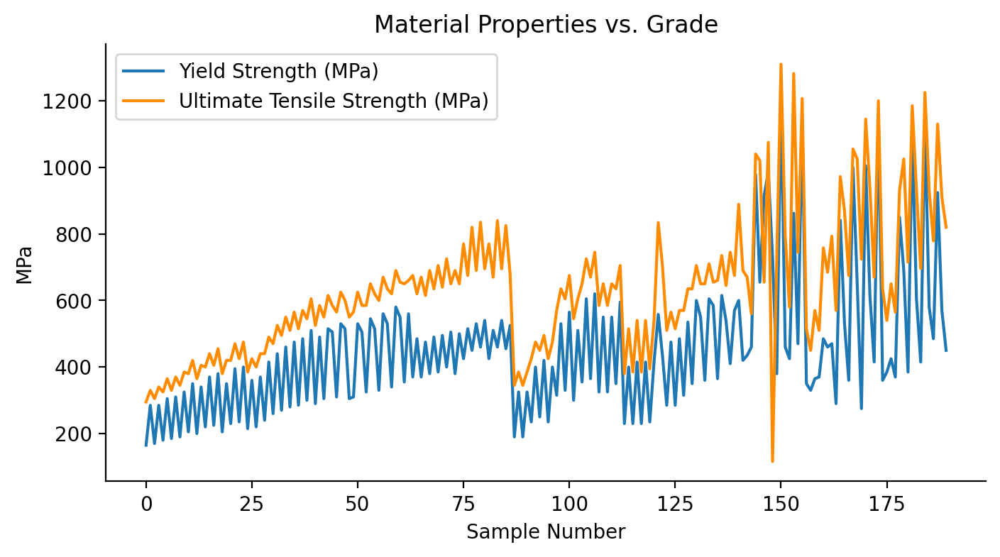

In [15]:
# Create the plot
fig, ax = plt.subplots(figsize=(8, 4))

# Plot Yield Strength (MPa) with blue color and label
ax.plot(df['ys_mpa'], label='Yield Strength (MPa)')

# Plot Ultimate Tensile Strength (MPa) with red color and label
ax.plot(df['uts_mpa'], color='darkorange', label='Ultimate Tensile Strength (MPa)')

# Set labels and title
ax.set_xlabel('Sample Number')
ax.set_ylabel('MPa')
ax.set_title('Material Properties vs. Grade')

# Hide top and right spines
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.legend()


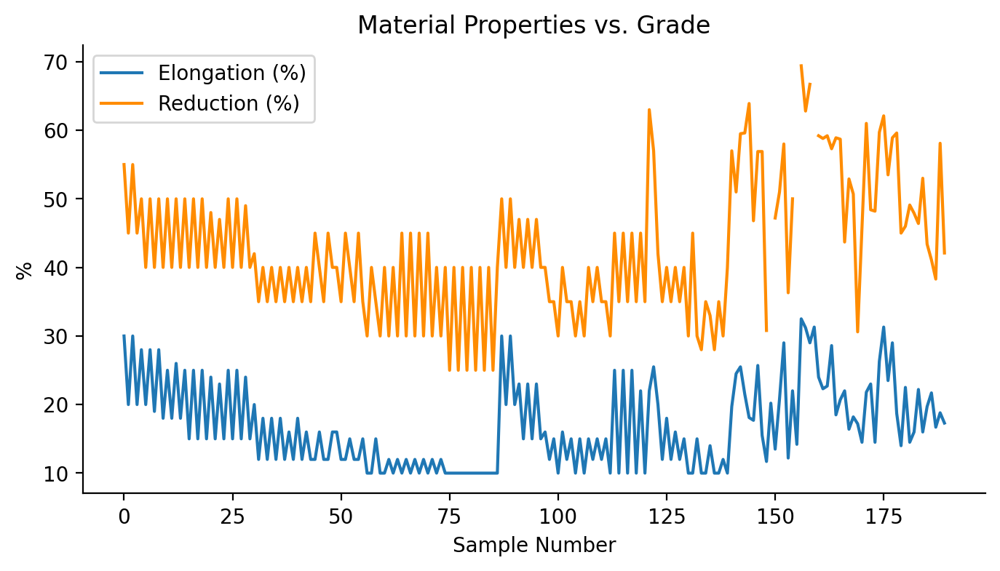

In [16]:
# Create the plot
fig, ax = plt.subplots(figsize=(8, 4))

# Plot Young's Modulus (MPa) with blue color and label
ax.plot(df['Elongation (%)'], label='Elongation (%)')

# Plot Ultimate Tensile Strength (MPa) with red color and label
ax.plot(df['Reduction (%)'], color='darkorange', label='Reduction (%)')

# Set labels and title
ax.set_xlabel('Sample Number')
ax.set_ylabel('%')
ax.set_title('Material Properties vs. Grade')

# Hide top and right spines
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.legend()

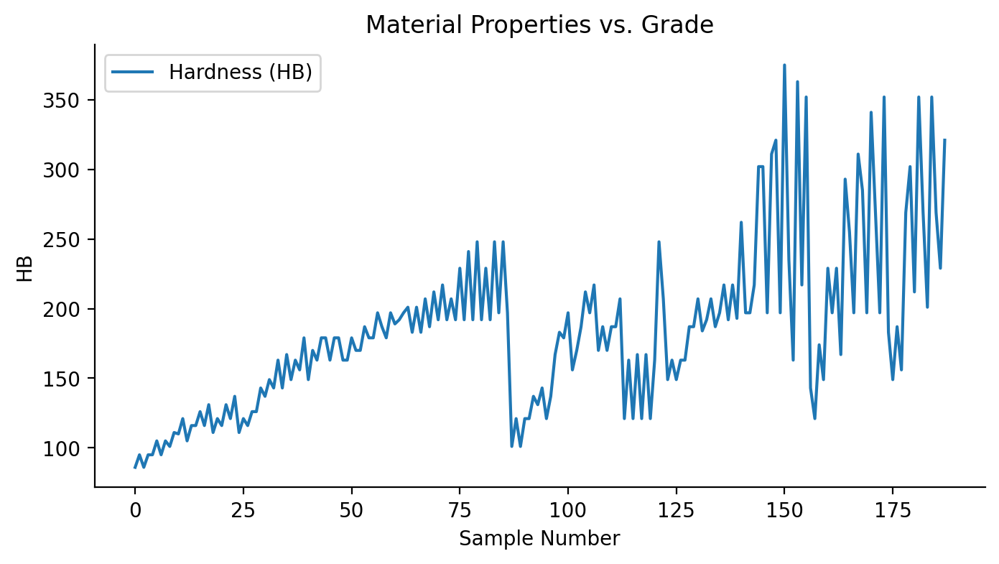

In [17]:
# Create the plot
fig, ax = plt.subplots(figsize=(8, 4))

# Plot Young's Modulus (MPa) with blue color and label
ax.plot(df['Hardness (HB)'], label='Hardness (HB)')


# Set labels and title
ax.set_xlabel('Sample Number')
ax.set_ylabel('HB')
ax.set_title('Material Properties vs. Grade')

# Hide top and right spines
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.legend()

In [18]:
# Features (X)
x = df[['grade', 'condition']]

# Target variable (y)
y = df[['uts_mpa', 'ys_mpa']]

print(f'Shape of X: {x.shape}')
print(f'Shape of y: {y.shape}')

Shape of X: (190, 2)
Shape of y: (190, 2)


In [19]:
#Splitting data for training and testing
X_train,X_test,y_train,y_test=train_test_split(x,y,test_size=0.20,random_state=RNG_SEED)
print(X_train.shape)
print(X_test.shape)

(152, 2)
(38, 2)


In [20]:
#analysing the grades
num_rows = len(X_train)
print(f'There are in total {num_rows} rows in the X_train DataFrame.')

unique_grade=x['grade'].unique()
num_unique_grade = len(X_train['grade'].unique())
print(f'But there are only {num_unique_grade} unique grades of carbon steel!\n{unique_grade} \n')

print('Unique grade occurances in the X_train DataFrame:')
print(X_train['grade'].value_counts(), '\n')
print('Unique grade occurances in the X_test DataFrame:')
print(X_test['grade'].value_counts())

There are in total 152 rows in the X_train DataFrame.
But there are only 80 unique grades of carbon steel!
['1006' '1008' '1010' '1012' '1015' '1016' '1017' '1018' '1019' '1020'
 '1021' '1022' '1023' '1025' '1026' '1030' '1035' '1037' '1038' '1039'
 '1040' '1042' '1043' '1044' '1045' '1046' '1049' '1050' '1055' '1060'
 '1064' '1065' '1070' '1074' '1078' '1080' '1084' '1085' '1086' '1090'
 '1095' '1108' '1109' '1117' '1118' '1119' '1132' '1137' '1140' '1141'
 '1144' '1145' '1146' '1151' '1211' '1212' '1213' '12l14' '1340' '1524'
 '1527' '1536' '1541' '1547' '1548' '1552' '3140' '4130' '4140' '4150'
 '4320' '4340' '4419' '4620' '4820' '5140' '5150' '5160' '6150' '8620'
 '8630' '8650' '8740' '9255' '9310'] 

Unique grade occurances in the X_train DataFrame:
grade
1045    3
1541    3
4130    3
8740    3
9255    3
       ..
1132    1
1030    1
1536    1
1080    1
1140    1
Name: count, Length: 80, dtype: int64 

Unique grade occurances in the X_test DataFrame:
grade
1524     2
1065     2
11

In [21]:
#dividing data for testing, training and validation.
np.random.seed(seed=RNG_SEED)
all_grade=unique_grade.copy()
val_size=0.20
test_size=0.10
train_size=1-val_size-test_size


num_val_samples=int(round(val_size*len(unique_grade)))
num_test_samples=int(round(test_size*len(unique_grade)))
num_train_samples=int(round(train_size*len(unique_grade)))


val_grade=np.random.choice(all_grade,size=num_val_samples,replace=False)
all_grade=[f for f in all_grade if f not in val_grade]


test_grade=np.random.choice(all_grade,size=num_val_samples,replace=False)
all_grade=[f for f in all_grade if f not in test_grade]

train_grade=all_grade.copy()


print('Number of training formulae: ',len(train_grade))
print('Number of validation formulae: ',len(val_grade))
print('Number of testing formulae: ',len(test_grade))

Number of training formulae:  51
Number of validation formulae:  17
Number of testing formulae:  17


In [22]:
# Split the DataFrame based on the grades into training, validation, and test sets
df_train = df[df['grade'].isin(train_grade)]
df_val = df[df['grade'].isin(val_grade)]
df_test = df[df['grade'].isin(test_grade)]

# Print the shapes of the datasets
print(f'Train dataset shape: {df_train.shape}')
print(f'Validation dataset shape: {df_val.shape}')
print(f'Test dataset shape: {df_test.shape}\n')

# Print the first few rows of each dataset
print('Train dataset head:')
print(df_train.head(), '\n')

print('Validation dataset head:')
print(df_val.head(), '\n')

print('Test dataset head:')
print(df_test.head(), '\n')

Train dataset shape: (115, 26)
Validation dataset shape: (38, 26)
Test dataset shape: (37, 26)

Train dataset head:
   grade   condition  uts_mpa  UTS (Ksi)  ys_mpa  YS (ksi)  Elongation (%)  \
2   1008  Hot rolled      305         44     170      24.5            30.0   
3   1008  Cold drawn      340         49     285      42.0            20.0   
6   1012  Hot rolled      330         48     185      27.0            28.0   
7   1012  Cold drawn      370         54     310      45.0            19.0   
12  1017  Hot rolled      365         53     200      29.0            26.0   

    Reduction (%)  Hardness (HB)  c_min  ...  S(Max)  Si (Min)  Si (Max)  \
2            55.0           86.0    NaN  ...    0.05       NaN       NaN   
3            45.0           95.0    NaN  ...    0.05       NaN       NaN   
6            50.0           95.0   0.10  ...    0.05       NaN       NaN   
7            40.0          105.0   0.10  ...    0.05       NaN       NaN   
12           50.0          105.0   

In [23]:
#Checking for error in dividing, if any grade got selcected for more than one scenario.
train_grade = set(df_train['grade'].unique())
val_grade = set(df_val['grade'].unique())
test_grade = set(df_test['grade'].unique())

common_grade1 = train_grade.intersection(test_grade)
common_grade2 = train_grade.intersection(val_grade)
common_grade3 = test_grade.intersection(val_grade)

print(f'# of common grade in intersection 1: {len(common_grade1)}; common grade: {common_grade1}')
print(f'# of common grade in intersection 2: {len(common_grade2)}; common grade: {common_grade2}')
print(f'# of common grade in intersection 3: {len(common_grade2)}; common grade: {common_grade2}')

# of common grade in intersection 1: 0; common grade: set()
# of common grade in intersection 2: 0; common grade: set()
# of common grade in intersection 3: 0; common grade: set()


In [24]:
#After assuring no mix up in data arrangement, we proceed
# Define the file paths
#Path can be editted as per wish.
train_path = os.path.join('/content/cp_train.csv')
val_path = os.path.join('/content/cp_val.csv')
test_path = os.path.join('/content/cp_test.csv')

# Save the DataFrames to CSV files
df_train.to_csv(train_path, index=False)
df_val.to_csv(val_path, index=False)
df_test.to_csv(test_path, index=False)